In [1]:
import numpy as np
import scipy.io as sio
import matplotlib.pyplot as plt
from caiman.source_extraction.cnmf.cnmf import load_CNMF as load_CNMF
import caiman as cm

In [29]:
file_path = '/home/melisamc/Documentos/acc_2p_analysis/data/'
figure_path = '/home/melisamc/Documentos/acc_2p_analysis/figures/havaianna/'
filter_path = '/home/melisamc/Documentos/acc_2p_analysis/data/filter/'

triggers_file = 'trlMat_20220513.mat'
test = sio.loadmat(file_path + triggers_file)
print(test)
labels = test['trlMatLabels']
triggers_file= '20220513-165536_677_decoded_new_scan_trlInfo.mat'
traces_file_1 = 'havaianna_SE_gSig_4_mincorr_0.312_minpnr_2.3_traces_CE_snr_4_pcc_0.5_traces_accepted_complete.npy'
traces_file = 'havaianna_new_traces.npy'
traces_file_ring = 'havaianna_traces_sigma_5_ring_model.npy'
traces_file_ring1 = 'havaianna_traces_sigma_5_big_ring_model_.npy'
file_ring = 'havaianna_traces_sigma_5_ring_model_signal.npy'

filter_file = 'mean_image.npy'
countour_file = 'mouse_421851_year_2022_month_5_day_13_example_1__v.1.1.0.1.hdf5'

print(test)

{'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Wed Jun 29 10:59:22 2022', '__version__': '1.0', '__globals__': [], 'trlMat': array([[1.000000e+00, 1.000000e+00,          nan,          nan,
        5.234400e+04, 6.073900e+04, 6.166200e+04, 6.601400e+04,
        9.154100e+04, 9.154000e+04],
       [9.154100e+04, 1.000000e+00,          nan,          nan,
        9.895700e+04, 1.430540e+05, 1.440980e+05, 1.461260e+05,
        1.563210e+05, 6.478000e+04],
       [1.563220e+05, 2.000000e+00, 1.676740e+05, 1.696870e+05,
        1.749550e+05, 1.897360e+05, 1.917230e+05, 1.954070e+05,
        2.031220e+05, 4.680000e+04],
       [2.031230e+05, 2.000000e+00, 2.111900e+05, 2.131890e+05,
        2.476920e+05, 2.544450e+05, 2.555730e+05, 2.591050e+05,
        2.651170e+05, 6.199400e+04],
       [2.651180e+05, 2.000000e+00, 2.756300e+05, 2.776290e+05,
        2.990190e+05, 3.013720e+05, 3.070430e+05, 3.096650e+05,
        3.364130e+05, 7.129500e+04],
       [3.364140e+05, 3.0000

In [22]:
test = sio.loadmat(file_path + triggers_file)
events_time = test['trialInfo']
events_time = test['trialInfoScanFrames']


In [30]:
calcium_activity = np.load(file_path + traces_file)
calcium_activity_1 = np.load(file_path + traces_file_1)
calcium_activity_ring = np.load(file_path + traces_file_ring)
calcium_activity_ring1 = np.load(file_path + traces_file_ring1)

calcium_activity_ring2 = np.load(file_path + file_ring)


cn_filter = np.load(filter_path + filter_file)
cnm = load_CNMF(file_path + countour_file)

In [24]:
labels

array([[array(['environmentStart'], dtype='<U16'),
        array(['environmentID'], dtype='<U13'),
        array(['soundOnset'], dtype='<U10'),
        array(['soundOffset'], dtype='<U11'),
        array(['tunnel1Start'], dtype='<U12'),
        array(['rewardZoneStart'], dtype='<U15'),
        array(['rewardDelivery'], dtype='<U14'),
        array(['tunnel2Start'], dtype='<U12'),
        array(['tunnel2End'], dtype='<U10'),
        array(['trialDuration'], dtype='<U13')]], dtype=object)

In [25]:
srate = 30
stim_length = 25

sound1 = events_time[:,0][np.where(events_time[:,1] == 1)[0]]
sound1 = sound1[2:] #*srate / 1000
sound2 = events_time[:,0][np.where(events_time[:,1] == 2)[0]]#*srate/1000
sound3 = events_time[:,0][np.where(events_time[:,1] == 3)[0]]#*srate/1000

duration1 = events_time[:,9][np.where(events_time[:,1] == 1)[0]]#*srate/1000
duration1 = duration1[2:]#*srate / 1000

duration2 = events_time[:,9][np.where(events_time[:,1] == 2)[0]]#*srate/1000
duration3 = events_time[:,9][np.where(events_time[:,1] == 3)[0]]#*srate/1000

print(stim_length*srate/2)
print(events_time[:,9])


375.0
[18883. 18083. 17545. 18000. 18278. 17836. 19833. 18710. 18264. 18562.
 18283. 21252. 17606. 18750. 17930. 22093.]


In [26]:
sounds_list = []
sounds_list.append(sound1)
sounds_list.append(sound2)
sounds_list.append(sound3)

duration_list = []
duration_list.append(duration1)
duration_list.append(duration2)
duration_list.append(duration3)

print('sounds')
print(sounds_list)
print('trial duration')
print(duration_list)

sounds
[array([40986., 48083., 67450., 70053.]), array([20823., 22222., 24075., 27897., 43550., 65990., 71837.]), array([26207., 45668., 50219.])]
trial duration
[array([18710., 18283., 18750., 17930.]), array([17545., 18000., 18278., 19833., 18264., 17606., 22093.]), array([17836., 18562., 21252.])]


In [31]:
C_0_1 = calcium_activity_1.copy()
C_0 = calcium_activity.copy()
C_0_2 = calcium_activity_ring.copy()
C_0_2_ = calcium_activity_ring1.copy()
C_0_3 = calcium_activity_ring2.copy()


print(C_0.shape)
print(C_0_1.shape)

(114, 80189)
(114, 80189)


/tmp/ipykernel_4171/169003588.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure, axes = plt.subplots(1)


IndexError: index 114 is out of bounds for axis 0 with size 114

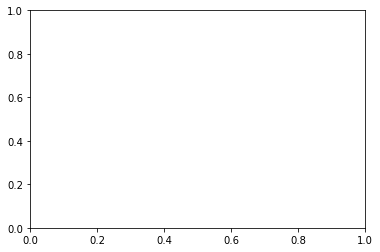

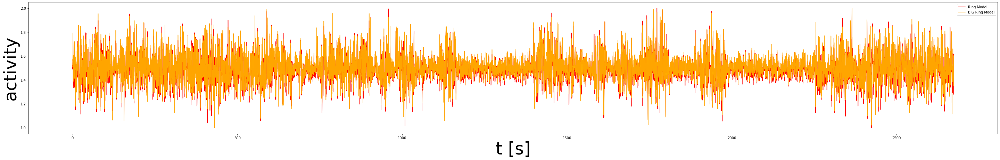

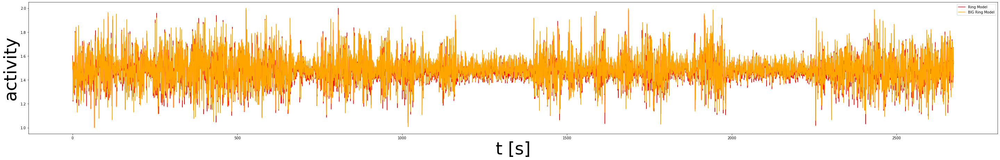

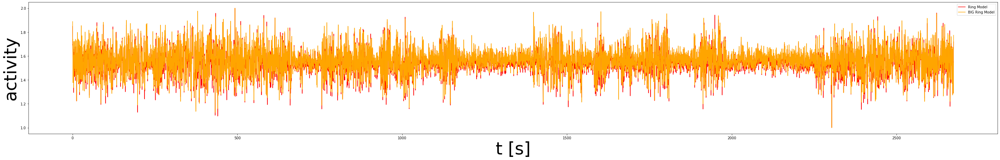

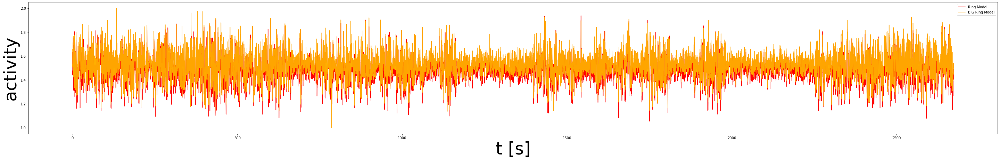

...

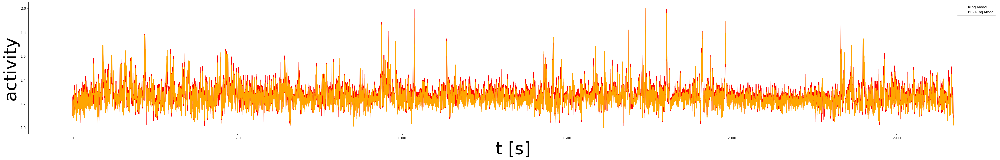

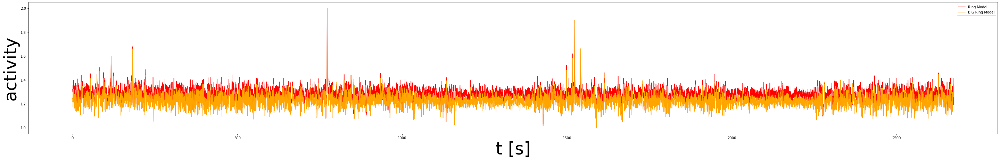

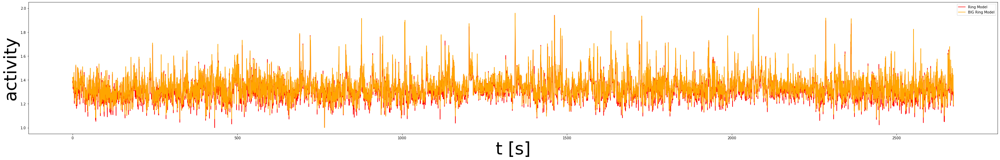

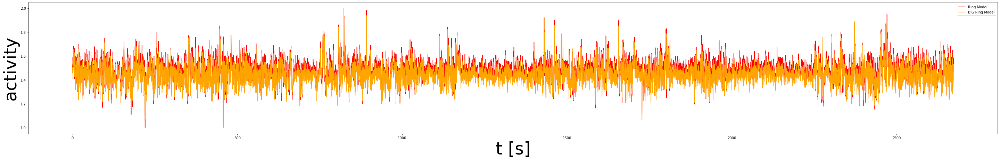

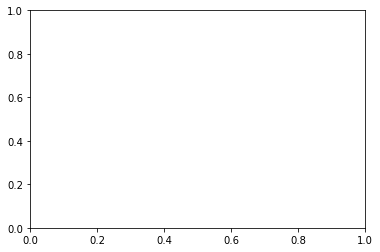

In [35]:
colors = ['r','b','g','magenta','orange','cyan']
#### plot temporal traces with multiple colors depending on the sound
figure, axes = plt.subplots(1)

rango =  np.arange(0, C_0.shape[1])
time = rango/ srate

# rango =  np.arange(300, 10000)
# time = rango / srate

for cell_index in range(1, 140):
    figure, axes = plt.subplots(1)
#     axes.plot(time, (C_0_1[cell_index,rango]-np.min(C_0_1[cell_index,rango])) / (np.max(C_0_1[cell_index,rango])-np.min(C_0_1[cell_index,rango])), c='b')
#     axes.plot(time, (C_0[cell_index,rango]-np.min(C_0[cell_index,rango])) / (np.max(C_0[cell_index,rango])-np.min(C_0[cell_index,rango]))+2, c='k')
#     axes.plot(time, (C_0_2[cell_index,rango]-np.min(C_0_2[cell_index,rango]))/ (np.max(C_0_2[cell_index,rango])-np.min(C_0_2[cell_index,rango]))+3, c='r')
#     axes.plot(time, (C_0_2[cell_index,rango]-np.min(C_0_2_[cell_index,rango]))/ (np.max(C_0_2_[cell_index,rango])-np.min(C_0_2_[cell_index,rango]))+3, c='magenta',alpha=0.5)
#     axes.plot(time, (C_0_3[cell_index,rango]-np.min(C_0_3[cell_index,rango])) / (np.max(C_0_3[cell_index,rango])-np.min(C_0_3[cell_index,rango]))+4, c='g')
#     axes.plot(time, C_0_1[cell_index,rango]+np.max(C_0_1[:cell_index,rango]), c='b')
#     axes.plot(time, C_0[cell_index,rango]+np.max(C_0[:cell_index,rango]), c='k')
    axes.plot(time, C_0_2[cell_index,rango]+np.max(C_0_2[:cell_index,rango]), c='r')
    axes.plot(time, C_0_2_[cell_index,rango]+np.max(C_0_2_[:cell_index,rango]), c='orange')
    #axes.plot(time, C_0_3[cell_index,rango]+np.max(C_0_3[:cell_index,rango]), c='g')


    axes.set_xlabel('t [s]', fontsize = 50)
    #axes.set_yticks([])
    axes.set_ylabel('Actvivity', fontsize = 50)
    #axes.legend(['CaImAnModel','Cell activity Background_sustraction','Cell activity Ring_sustraction','Cell activity BIGRing_sustraction','Ring activity_background_sustraction'],fontsize = 25)
#    axes.legend(['Cell_activity_background_sustraction','Cell_activity_Ring_back_sustraction','Ring_activity_background_sustraction'],fontsize = 25)
    axes.legend(['Ring Model', 'BIG Ring Model'])
    axes.set_ylabel('activity')
    figure.set_size_inches([50,7])
    figure.patch.set_facecolor('white')

    figure.savefig(figure_path + 'cell_examples/'+ 'havaianna_traces_units_'+f'{cell_index}'+'_4.png')

(114, 80189)


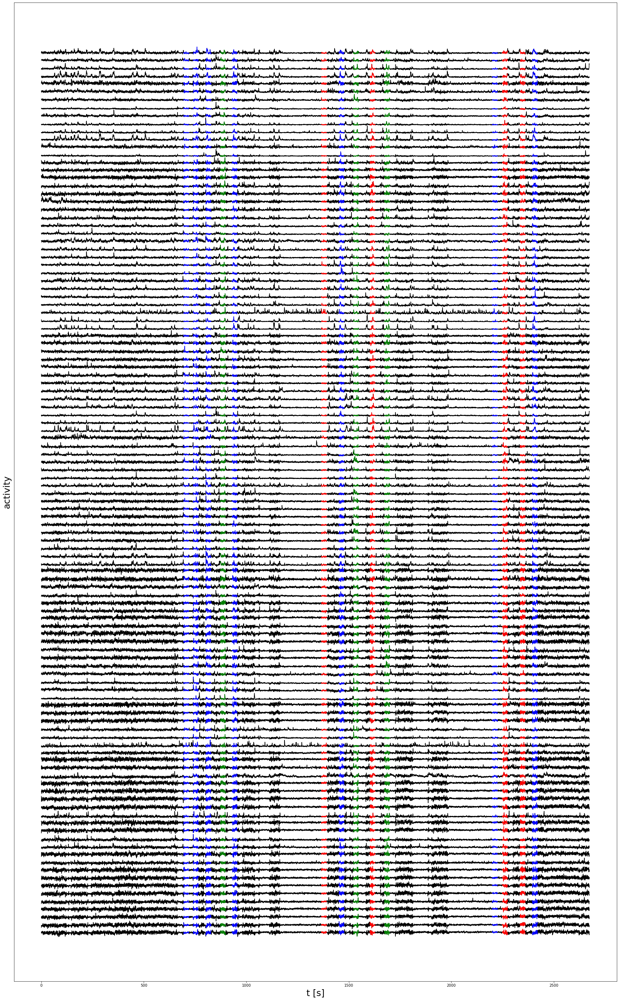

In [16]:
C_0 = calcium_activity_ring2.copy()
print(C_0.shape)

colors = ['r','b','g','magenta','orange','cyan']
#### plot temporal traces with multiple colors depending on the sound
figure, axes = plt.subplots(1)

for cell_index in range(1, C_0.shape[0]):
    #C_0[cell_index] += C_0[cell_index].min() + C_0[:cell_index].max()
    axes.plot(np.arange(0, len(C_0[cell_index])) / srate, C_0[cell_index,:] / np.max(C_0[cell_index,:])+ cell_index, c='k')
    for sound_index in range(len(sounds_list)):
        #for j in range(0,len(sounds_list[sound_index])):
        for j in range(0,sounds_list[sound_index].shape[0]):
            sound_onset = int(sounds_list[sound_index][j])
            sound_end = int(sound_onset  + stim_length  * srate)
            #sound_end = int(sound_onset  + duration_list[sound_index][j])

            axes.plot(np.arange(sound_onset,sound_end)/srate,C_0[cell_index][sound_onset:sound_end]/np.max(C_0[cell_index,:])+cell_index, c = colors[sound_index])

axes.set_xlabel('t [s]', fontsize = 25)
axes.set_yticks([])
axes.set_ylabel('Actvivity', fontsize = 25)

axes.set_ylabel('activity')
figure.set_size_inches([30,50])
figure.patch.set_facecolor('white')

figure.savefig(figure_path + 'havaianna_traces_environment_raw_sigma_5_ring_signal.png')

cell number =  0
cell number =  1
cell number =  2
cell number =  3
cell number =  4
cell number =  5
cell number =  6
cell number =  7
cell number =  8
cell number =  9
cell number =  10
cell number =  11
cell number =  12
cell number =  13
cell number =  14
cell number =  15
cell number =  16
cell number =  17
cell number =  18
cell number =  19
cell number =  20
cell number =  21
cell number =  22
cell number =  23
cell number =  24
cell number =  25
cell number =  26
cell number =  27
cell number =  28
cell number =  29
cell number =  30
cell number =  31
cell number =  32
cell number =  33
cell number =  34
cell number =  35
cell number =  36
cell number =  37
cell number =  38
cell number =  39
cell number =  40
cell number =  41
cell number =  42
cell number =  43
cell number =  44
cell number =  45
cell number =  46
cell number =  47
cell number =  48
cell number =  49
cell number =  50
cell number =  51
cell number =  52
cell number =  53
cell number =  54
cell number =  55
ce

IndexError: index 114 is out of bounds for axis 0 with size 114

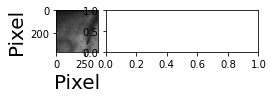

In [36]:

stim_lenght = stim_length
audio_matrix_list = []
iti_matrix_list = []
mean_sound_activity_evolution_list = []
mean_iti_activity_evolution_list = []
C_0 = calcium_activity.copy()
n_neurons = C_0.shape[1]
timeline = [0,0]

for sound_index in range(len(sounds_list)):
    #create matrix to contain mean activity of all neurons over trials
    sound_matrix = np.zeros((n_neurons,int(stim_lenght*srate*1.5)))
    audio_matrix_list.append(sound_matrix)

    #create matrix to contrain mean activity evolution over trials
    sound_mean = np.zeros((n_neurons,len(sounds_list[sound_index])))
    mean_sound_activity_evolution_list.append(sound_mean)


traces = calcium_activity.copy()
### zscored traces
traces_zscored = traces - traces.mean(axis = 1, keepdims = True) / traces.std(axis = 1, keepdims = True)
### normed traces
traces_normed = (traces_zscored - traces_zscored.min(axis=1,keepdims = True))/(traces_zscored.max(axis=1, keepdims = True) - traces_zscored.min(axis = 1, keepdims = True))
C_final = traces_normed

for n in range(n_neurons):
    print('cell number = ' , n)
    #figure, axes = plt.subplots(1,4)
    # create a figure for every neuron
    figure = plt.figure()
    gs = plt.GridSpec(15,48)
    axes = figure.add_subplot(gs[0:3, 0:12])
    axes.imshow(cn_filter, cmap='gray')
    coordinates = cm.utils.visualization.get_contours(cnm.estimates.A[:,cnm.estimates.idx_components],cn_filter.shape,0.2,'max')
    counter = 0
    for c in coordinates:
        if counter == n:
            v = c['coordinates']
            c['bbox'] = [np.floor(np.nanmin(v[:, 1])), np.ceil(np.nanmax(v[:, 1])),
                         np.floor(np.nanmin(v[:, 0])), np.ceil(np.nanmax(v[:, 0]))]
            axes.plot(*v.T, c='r')
        counter = counter + 1
    axes.set_xlabel('Pixel',fontsize = 20)
    axes.set_ylabel('Pixel',fontsize = 20)


    axes = figure.add_subplot(gs[0:3, 10:32])
    axes.plot(np.arange(0, len(C_0[n])) / srate, C_final[n], c='k')
    axes.set_xlabel('time [s]', fontsize=25)
    axes.set_yticks([])
    axes.set_ylabel('Actvivity', fontsize=25)

    for sound_index in range(len(sounds_list)):
        for j in range(0,sounds_list[sound_index].shape[0]):
            sound_onset = int(sounds_list[sound_index][j] + timeline[1] - stim_lenght*srate/2) 
            sound_end = int(sound_onset  + stim_lenght  * srate)
            axes.plot(np.arange(sound_onset,sound_end)/srate,C_final[n][sound_onset:sound_end],  c = colors[sound_index])

    axes_0 = figure.add_subplot(gs[0:3, 37:48])
    #axes_1 = figure.add_subplot(gs[0:3, 40:48])

    for sound_index in range(len(sounds_list)): # for everysound
        ### create matrix con trials
        aux_matrix_sound = np.zeros((len(sounds_list[sound_index]), int(stim_lenght*srate*1.5)))
        aux_time = np.arange(0,stim_lenght,1/srate)
        for trial in range(0, len(sounds_list[sound_index])):
            sound_onset = int(sounds_list[sound_index][trial] + timeline[1]- stim_lenght*srate/2)
            aux_matrix_sound[trial,:] = C_final[n][sound_onset:sound_onset+int(stim_lenght*srate*1.5)]
        #mean_activity = np.mean(aux_matrix_sound,axis = 0)

        ### z-score and normalize traces
        # aux_matrix_zs = (aux_matrix_sound - aux_matrix_sound.mean(axis = 1, keepdims = True))/ aux_matrix_sound.std(axis = 1,keepdims=True)
        mean_sound_activity_evolution_list[sound_index][n,:] = np.mean(aux_matrix_sound,axis=1)
        # matrix1_norm = (aux_matrix_zs - aux_matrix_zs.min(axis = 1,keepdims = True)) / (aux_matrix_zs.max(axis=1, keepdims = True) - aux_matrix_zs.min(axis = 1,keepdims= True))
        final_matrix = aux_matrix_sound

        axes = figure.add_subplot(gs[13:15, sound_index * 17 : sound_index * 17 +15])
        mean_activity = np.mean(final_matrix,axis = 0)
        std_activity = np.std(final_matrix,axis = 0)#/np.sqrt(matrix1.shape[0])
        ###save the mean for population analysis
        audio_matrix_list[sound_index][n,:] = mean_activity
        temporal_var = np.arange(0,len(mean_activity))/srate - stim_lenght/2
        axes.fill_between(temporal_var,mean_activity - std_activity,mean_activity + std_activity, alpha = 0.1, color = colors[sound_index])
        axes.plot(temporal_var,mean_activity, color = colors[sound_index], linewidth = 2)
        axes.vlines(0,-0.1,1,color = 'k')
        
        #axes.set_yticks([])
        axes.set_ylim([-0.15,1])
        if sound_index == 0:
            axes.set_ylabel('Mean Activity', fontsize = 15)
        axes.set_xlabel('time [s]', fontsize=15)

        axes_0.fill_between(temporal_var, mean_activity - std_activity, mean_activity + std_activity, alpha=0.1,
                          color = colors[sound_index])
        axes_0.plot(temporal_var, mean_activity, color = colors[sound_index], linewidth=2)
        # axes.set_yticks([])
        axes_0.vlines(0,-0.1,0.3,color = 'k')
        axes_0.set_ylim([-0.15, 1])
        axes_0.set_ylabel('Mean Activity', fontsize=15)
        axes_0.set_xlabel('time [s]', fontsize=15)


        axes = figure.add_subplot(gs[5:12,sound_index * 17  : sound_index * 17 +15])
        final_matrix[0,:] += final_matrix[0].min()
        axes.plot(temporal_var,final_matrix[0], c = 'k')
        for j in range(1,len(sounds_list[sound_index])):
            final_matrix[j] += final_matrix[j].min() + 0.1 * j #+ final_matrix[:j].max()
            axes.plot(temporal_var,final_matrix[j], c = 'k')
        axes.set_yticks([])
        axes.set_title('SOUND = ' + f'{sound_index+1}' , fontsize=12)
    #    axes.set_xlabel('t [s]', fontsize=10)
        if sound_index == 0:
            axes.set_ylabel('Trials', fontsize = 20)


    figure.set_size_inches([25,10])
    figure.patch.set_facecolor('white')
    figure.savefig(figure_path + 'traces_normed_neuron_raw' + f' {n}' + '.png')

    plt.close()



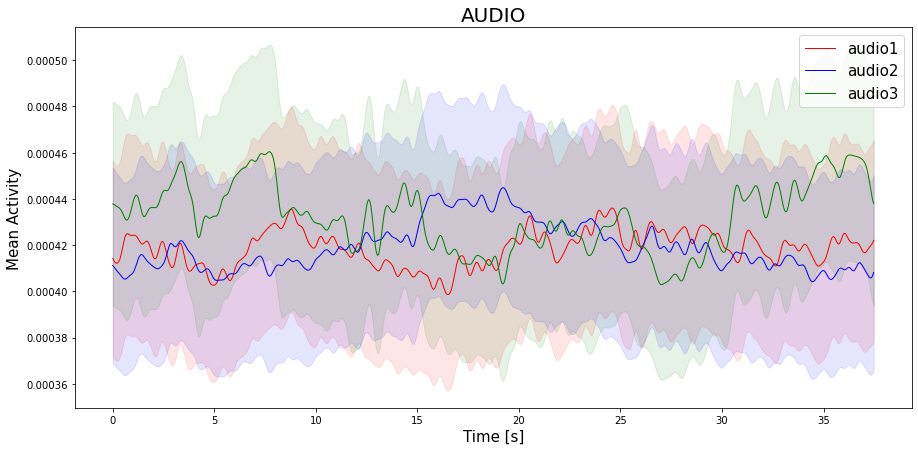

In [17]:
figure = plt.figure()
gs = plt.GridSpec(1, 9)
axes = figure.add_subplot(gs[0, 0: 9])

for sound_index in range(len(sounds_list)):

    mean_activity = np.nanmean(audio_matrix_list[sound_index], axis = 0)
    std_activity = np.nanstd(audio_matrix_list[sound_index],axis = 0)/np.sqrt(n_neurons)
    temporal_var = np.arange(0, len(mean_activity)) / srate

    axes.plot(temporal_var, mean_activity, c=colors[sound_index], linewidth=1)

    axes.set_xlabel('Time [s]',fontsize = 15)
    axes.set_ylabel('Mean Activity',fontsize = 15)
    axes.set_title('AUDIO',fontsize = 20)
    #axes.set_ylim([0.012,0.03])
    
for sound_index in range(len(sounds_list)):

    mean_activity = np.nanmean(audio_matrix_list[sound_index], axis = 0)
    std_activity = np.nanstd(audio_matrix_list[sound_index],axis = 0)/np.sqrt(n_neurons)
    temporal_var = np.arange(0, len(mean_activity)) / srate
    axes.fill_between(temporal_var, mean_activity - std_activity, mean_activity + std_activity, alpha=0.1, color=colors[sound_index])


#axes.set_ylim([0.3,0.4])
axes.legend(['audio1','audio2','audio3'], fontsize = 15)

figure.set_size_inches([15,7])
figure.patch.set_facecolor('white')
figure.savefig(figure_path + 'traces_normed_neuron_mean_raw.png')


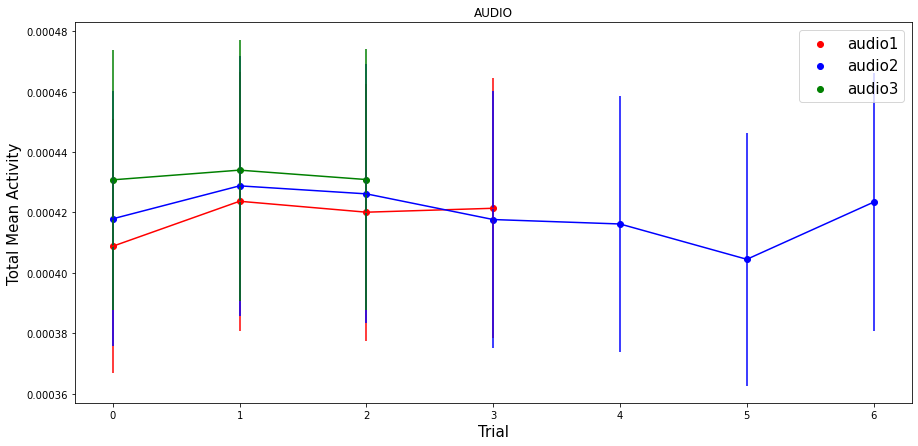

In [18]:
figure, axes = plt.subplots(1)

for sound_index in range(len(mean_sound_activity_evolution_list)):
    trial_id = np.arange(0,mean_sound_activity_evolution_list[sound_index].shape[1])
    axes.scatter(trial_id,np.nanmean(mean_sound_activity_evolution_list[sound_index],axis=0), c = colors[sound_index])

for sound_index in range(len(mean_sound_activity_evolution_list)):
    trial_id = np.arange(0,mean_sound_activity_evolution_list[sound_index].shape[1])    
    axes.errorbar(trial_id,np.nanmean(mean_sound_activity_evolution_list[sound_index],axis=0),np.nanstd(mean_sound_activity_evolution_list[sound_index],axis=0)/np.sqrt(mean_sound_activity_evolution_list[sound_index].shape[0]), c = colors[sound_index])


axes.set_xlabel('Trial', fontsize = 15)
axes.set_ylabel('Total Mean Activity', fontsize = 15)
axes.legend(['audio1','audio2','audio3'], fontsize = 15)
axes.set_title('AUDIO')
#axes[0].set_ylim([0,0.12])

figure.set_size_inches([15,7])
figure.patch.set_facecolor('white')
figure.savefig(figure_path + 'traces_all_neuron_mean_trial_normed_evolution_raw.png')